#### Example notebook to demonstrate usage of functions in biosynseq.metrics and biosynseq.visualize for the following purposes:
- Visualize embeddings for generated, test, or validation sequences using t-SNE and UMAP.
- Plot the embedding L2 distance against the pairwise global/local alignment scores for the embeddings.
- Plot the histogram distributions for each sequence metric.
- Plot the histogram distributions of mean, max, and min alignment scores between the alignment of two collections of sequences. <br>

These visualizations allow the user to evaluate the performance of a deep learning model in terms of learning important sequence properties and generating novel nucleotide sequences with relevant properties. 

In [1]:
from biosynseq import metrics
from biosynseq import visualize
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from Bio.Seq import Seq
from Bio import SeqIO
from Bio.SeqRecord import SeqRecord
from pathlib import Path
import h5py
from datetime import datetime
from tqdm import tqdm
from collections import defaultdict, Counter
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
%config InlineBackend.figure_format='retina'
%matplotlib inline
plt.rcParams['figure.figsize'] = [8,6]
plt.rcParams["font.family"] = "sans-serif"
plt.rcParams.update({'font.size':14})

In [3]:
def get_gc(seq: np.ndarray) -> float:
    """Returns percentage GC content given sequence as a numpy array"""
    g_content = np.sum(seq == "G")
    c_content = np.sum(seq == "C")
    return (g_content + c_content) / len(seq)

def get_paint_df(dna_seqs):
    paint_df = pd.DataFrame(
        {
            "GC": metrics.gc_content(dna_seqs),
            "SequenceLength": metrics.seq_length(dna_seqs),
        }
    )
    return paint_df

def load_seqs(h5_path):
    with h5py.File(h5_path, "r") as f:
        seqs = f["sequence"][...]
        descriptions = f["description"][...]
        ids = f["id"][...]
        
    seqs = [i.decode("utf-8") for i in seqs]
    descriptions = [i.decode("utf-8") for i in descriptions]
    ids = [i.decode("utf-8") for i in ids]
        
    seqs = [
        SeqRecord(
            Seq(seq),
            id=id_,
            name=id_,
            description=description,
        ) 
        for seq, id_, description in zip(seqs, ids, descriptions)
    ]

    
    return seqs, descriptions, ids


def get_classes(descriptions):
    classes = defaultdict(list)
    for item in descriptions:
        fields = item.decode("utf-8").split("|")
        classes["strain"].append(fields[0])
        classes["variant"].append(fields[1])
        classes["region"].append(fields[2])
        classes["species"].append(fields[3])
        classes["variant-label"].append(fields[1].split(".")[0][0])
        classes["region-label"].append(fields[2].split(":")[0])
        classes["time"].append(fields[4])
        
    return pd.DataFrame(classes)

# 1. Get t-SNE plots

### SARS-CoV-2 Genomes sequences

In [57]:
val_embed_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/25m_genome_val_embeddings.npy")
val_h5_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/mcov_h5/MCoV-high-quality_no_ambig_or_gap_val.h5")

seqs, descriptions, ids = load_seqs(val_h5_path)
embed_avg = np.load(val_embed_path)

AttributeError: 'str' object has no attribute 'decode'

In [5]:
embed_avg.shape

(3392, 512)

In [11]:
labels = get_paint_df(seqs)

{'GC':             z0         z1         GC
 0     3.481649  -7.883403  37.994670
 1     9.733963  -2.174672  38.011973
 2     8.290599   7.420684  37.983607
 3     0.742282  -3.760906  38.004686
 4    -0.597793  -5.387051  37.936390
 ...        ...        ...        ...
 3387  3.571535  -8.067660  37.987583
 3388 -8.742567  14.906260  37.959335
 3389  4.339467  -8.707918  37.957240
 3390  8.947654   7.446512  37.970115
 3391 -0.104998  -2.374691  38.031282
 
 [3392 rows x 3 columns],
 'SequenceLength':             z0         z1  SequenceLength
 0     3.481649  -7.883403           29641
 1     9.733963  -2.174672           29567
 2     8.290599   7.420684           29647
 3     0.742282  -3.760906           29449
 4    -0.597793  -5.387051           29618
 ...        ...        ...             ...
 3387  3.571535  -8.067660           29636
 3388 -8.742567  14.906260           29608
 3389  4.339467  -8.707918           29607
 3390  8.947654   7.446512           29647
 3391 -0.104998  -2

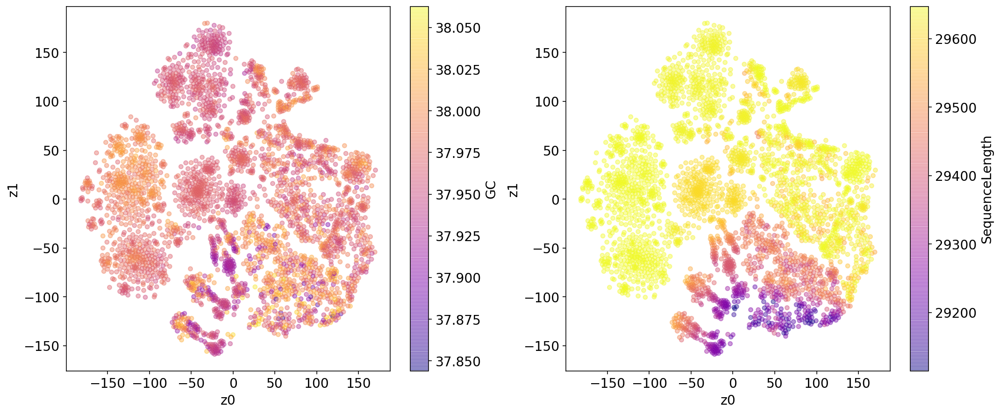

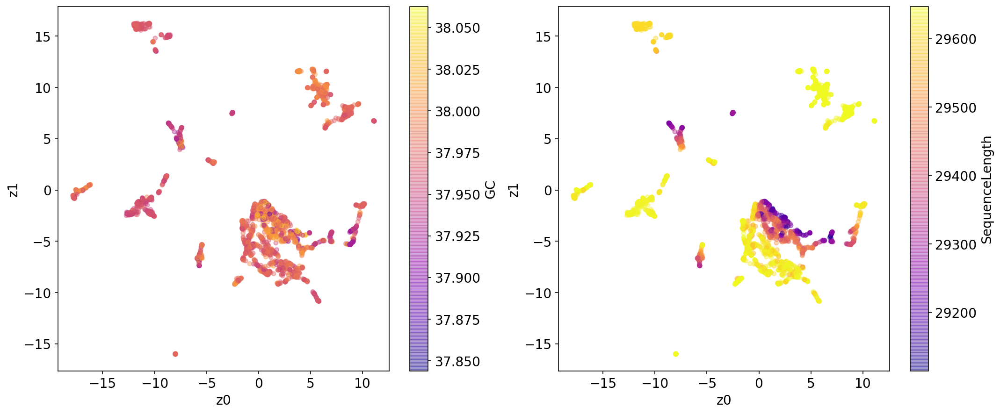

In [13]:
# if getting all plots as subplots of a collective image, add the argument get_subplots=True
df = visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="tsne", get_subplots=True)
visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="umap", get_subplots=True)

# Train sequences

In [4]:
train_embed_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/25m_genome_train_embeddings.npy")
train_h5_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/mcov_h5/MCoV-high-quality_no_ambig_or_gap_train.h5")

seqs, descriptions, ids = load_seqs(train_h5_path)
embed_avg = np.load(train_embed_path)

annotation_df = pd.read_csv("/homes/abrace/data/sequences/sars-cov2-genome/jim-data/Table_S1.csv", skiprows=1)
train_inds = np.concatenate([
    annotation_df.index[annotation_df["Genome ID"] == d]
    for d in descriptions
])
train_annotation_df = annotation_df.iloc[train_inds]
train_annotation_df = train_annotation_df[annotation_df["N Characters in the Genome*"] < 257] # This line may mess up phylogeny seqs
print("Genomes after filter:", len(train_annotation_df))
valid_annotation_inds = np.array([d in train_annotation_df["Genome ID"].values for d in descriptions])

# Some of the Genome ID's don't have annotations so we need to find the subset that do
# and index into the embeddings at those indices. valid_annotation_inds has a True bool if 
# the embedding index has an annotation
embed_avg = embed_avg[valid_annotation_inds]
seqs = [seq for i, seq in enumerate(seqs) if valid_annotation_inds[i]]
descriptions = [desc for i, desc in enumerate(descriptions) if valid_annotation_inds[i]]
assert len(embed_avg) == len(seqs)
assert len(descriptions) == len(embed_avg)
labels = get_paint_df(seqs)


/lambda_stor/homes/abrace/src/mdlearn/conda-env/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]


Genomes after filter: 16545


In [5]:
train_annotation_df

,Genome ID,GISAID ID,Collection Date,N Characters in the Genome*,Instrument,Ct-Value,Variant (Pangolin)
8968,MCoV-18768,EPI_ISL_785100,2020-11-23,256.0,ALINITY,26.88,B.1.2
23261,MCoV-58925,EPI_ISL_5346564,2021-08-25,256.0,ALINITY,15.22,AY.3
1099,MCoV-15958,EPI_ISL_785642,2020-07-10,256.0,ALINITY,37.94,B.1
22295,MCoV-56261,EPI_ISL_5343000,2021-08-17,256.0,PANTHER,17.80,AY.25
3817,MCoV-44519,EPI_ISL_5084777,2020-07-28,256.0,CEPHEID,22.90,B.1.1.342
...,...,...,...,...,...,...,...
30225,MCoV-77648,EPI_ISL_10818725,2022-01-07,256.0,ALINITY,25.37,omicron
31200,MCoV-78816,EPI_ISL_10819139,2022-01-11,256.0,ALINITY,18.82,omicron
5151,MCoV-12920,EPI_ISL_788072,2020-08-18,256.0,ALINITY,25.05,B.1.2
20134,MCoV-50978,EPI_ISL_5340193,2021-07-21,256.0,ALINITY,11.15,AY.25


20712


<AxesSubplot:>

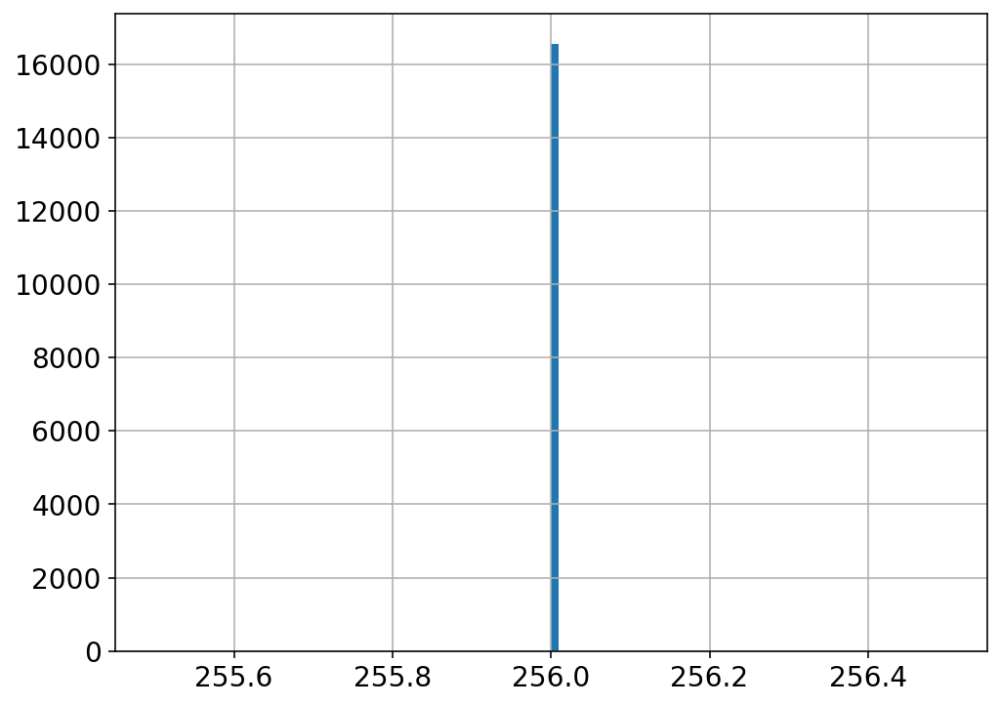

In [6]:
# This tells us we should remove genomes with more than 257 ambigous tokens
print(sum(annotation_df["N Characters in the Genome*"] < 257))
train_annotation_df["N Characters in the Genome*"].hist(bins=100)

<AxesSubplot:>

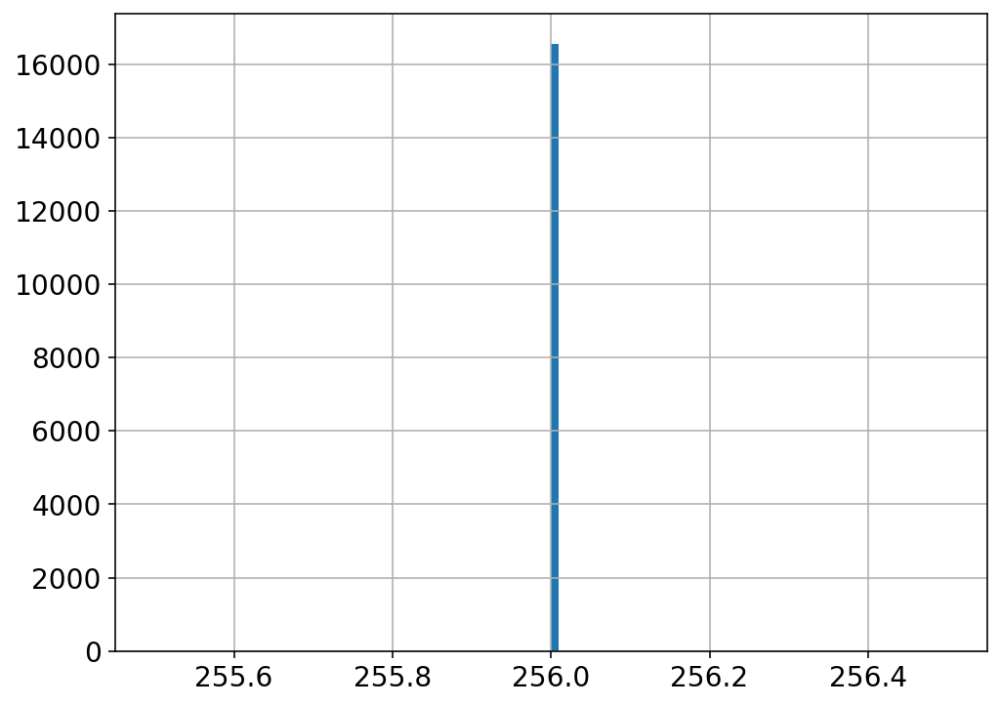

In [132]:
# After filtering
train_annotation_df["N Characters in the Genome*"].hist(bins=100)

In [7]:
corrected_sequences = list(SeqIO.parse("/homes/mzvyagin/jim_covid/MCoV-high-quality.fasta", "fasta"))

In [27]:
len(list(SeqIO.parse("/homes/abrace/data/sequences/Betacoronavirus.fna", "fasta")))

21651

In [8]:
# Need to load the original sequences, since the h5 file doesn't include ambigous tokens
# This logic assures that all of the annotated sequences in the train set are collected from the original fasta
# and allows us to build a phylogeny using a diverse subset of these.
corrected_id_to_ind_map = {seq.id: i for i, seq in enumerate(corrected_sequences)}
corrected_sequences = [corrected_sequences[corrected_id_to_ind_map[seq.id]] for seq in seqs]

[W] [08:59:40.895809] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...


{'GC':               z0          z1         GC
 0      91.535561   40.604050  37.976861
 1     -81.775856  102.157372  37.946624
 2     -39.059696 -144.448380  37.999460
 3      -2.414241  143.772049  37.960120
 4     -25.708527  -15.442986  37.980234
 ...          ...         ...        ...
 16540  90.840935  -45.257816  37.969468
 16541  43.591354  -39.123150  37.959335
 16542  61.777237   45.650944  37.990353
 16543 -27.514046  146.441391  37.970242
 16544 -50.041252 -108.280617  37.974812
 
 [16545 rows x 3 columns],
 'SequenceLength':               z0          z1  SequenceLength
 0      91.535561   40.604050           29647
 1     -81.775856  102.157372           29639
 2     -39.059696 -144.448380           29632
 3      -2.414241  143.772049           29639
 4     -25.708527  -15.442986           29647
 ...          ...         ...             ...
 16540  90.840935  -45.257816           29608
 16541  43.591354  -39.123150           29608
 16542  61.777237   45.650944           2

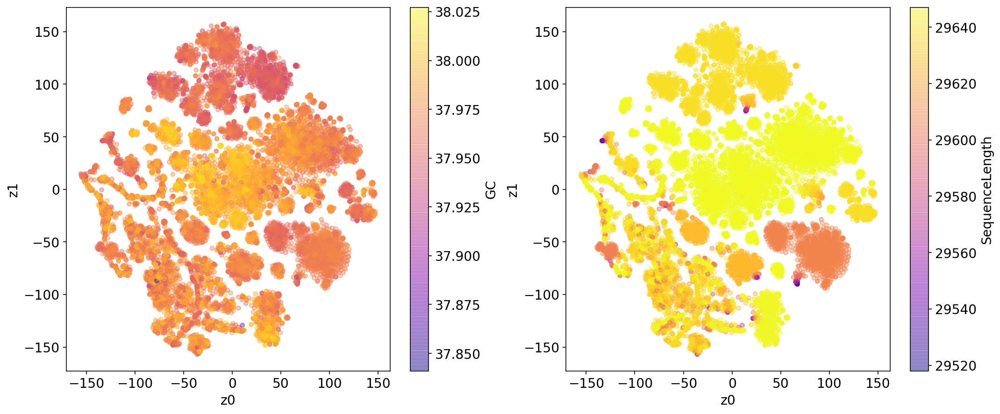

In [16]:
# if getting all plots as subplots of a collective image, add the argument get_subplots=True
tsne_df = visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="tsne", get_subplots=True)
plt.savefig("arvind-livermore-10-4-sars-cov2-genome-clustering-seqlen-gc.png", dpi=300)
tsne_df

# Painting with embedding distance

In [7]:
embed_avg[::25].shape

(662, 512)

In [8]:
from scipy.spatial import distance_matrix
dists = distance_matrix(embed_avg[::25], embed_avg[::25])

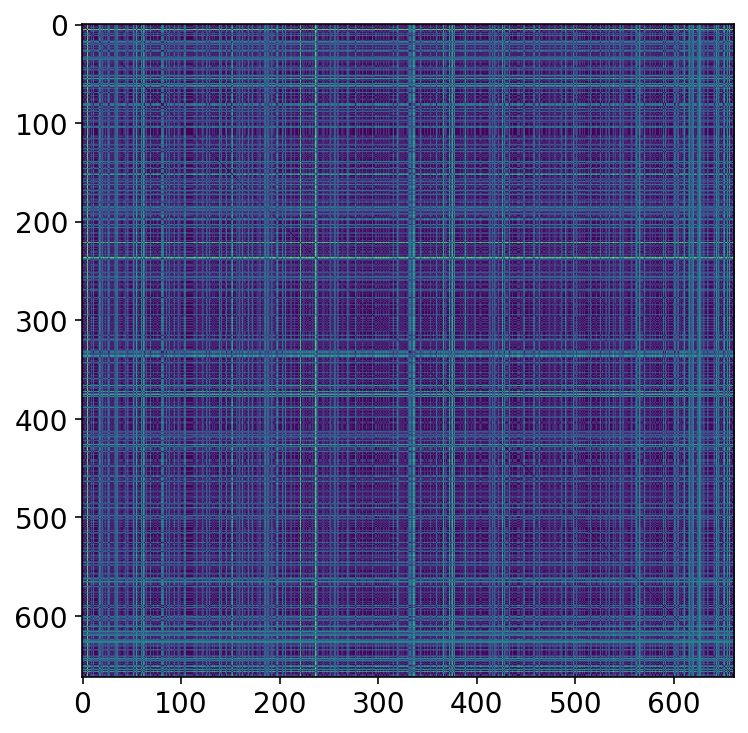

In [9]:
plt.imshow(dists)

In [70]:
dates = sorted(train_annotation_df["Collection Date"])
oldest_id = train_annotation_df["Genome ID"][train_annotation_df["Collection Date"] == dates[0]].values[0]
latest_id = train_annotation_df["Genome ID"][train_annotation_df["Collection Date"] == dates[-1]].values[0]
mid_id = train_annotation_df["Genome ID"][train_annotation_df["Collection Date"] == dates[round(len(dates) * 0.8)]].values[0]
mid2_id = train_annotation_df["Genome ID"][train_annotation_df["Collection Date"] == dates[round(len(dates) * 0.84)]].values[0]

oldest_idx = descriptions.index(oldest_id)
latest_idx = descriptions.index(latest_id)
mid_idx = descriptions.index(mid_id)
mid2_idx = descriptions.index(mid2_id)
print(oldest_idx, mid_idx, mid2_idx, latest_idx)
train_annotation_df[train_annotation_df["Genome ID"] == oldest_id]

9481 42 13 8683


,Genome ID,GISAID ID,Collection Date,N Characters in the Genome*,Instrument,Ct-Value,Variant (Pangolin)
5,MCoV-8369,EPI_ISL_784355,2020-06-16,256.0,CEPHEID,11.4,B.1.1


In [71]:
train_annotation_df[train_annotation_df["Genome ID"] == mid_id]

,Genome ID,GISAID ID,Collection Date,N Characters in the Genome*,Instrument,Ct-Value,Variant (Pangolin)
24174,MCoV-61247,EPI_ISL_5376198,2021-09-03,256.0,ALINITY,27.37,AY.25


In [72]:
train_annotation_df[train_annotation_df["Genome ID"] == mid2_id]

,Genome ID,GISAID ID,Collection Date,N Characters in the Genome*,Instrument,Ct-Value,Variant (Pangolin)
25148,MCoV-63356,EPI_ISL_5382795,2021-09-13,256.0,ALINITY,31.16,AY.26


In [73]:
train_annotation_df[train_annotation_df["Genome ID"] == latest_id]

,Genome ID,GISAID ID,Collection Date,N Characters in the Genome*,Instrument,Ct-Value,Variant (Pangolin)
31940,MCoV-79975,EPI_ISL_10822822,2022-01-14,256.0,ALINITY,33.77,omicron


In [108]:
oldest_embed_distances = np.array([np.linalg.norm(embed_avg[oldest_idx] - emb, ord=1) for emb in embed_avg])
latest_embed_distances = np.array([np.linalg.norm(embed_avg[latest_idx] - emb, ord=1) for emb in embed_avg])
mid_embed_distances = np.array([np.linalg.norm(embed_avg[mid_idx] - emb, ord=1) for emb in embed_avg])
mid2_embed_distances = np.array([np.linalg.norm(embed_avg[mid2_idx] - emb, ord=1) for emb in embed_avg])
oldest_embed_distances.shape

(16545,)

In [109]:
int(datetime.strptime(train_annotation_df["Collection Date"].values[0], "%Y-%m-%d").strftime("%Y%m%d"))

20201123

[W] [19:36:49.590058] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...


{'Collection Date':                z0          z1  Collection Date
 0       83.282829  -83.470627         20201123
 1      -36.037796  110.812912         20210825
 2     -110.002335  -86.562286         20200710
 3       27.476065  118.156586         20210817
 4       20.150177    6.222163         20200728
 ...           ...         ...              ...
 16540    1.145691    8.526624         20220107
 16541   -6.472068  -51.979408         20220111
 16542   92.334564  -53.714874         20200818
 16543   53.061455  133.418381         20210721
 16544  -99.642899  -64.277061         20210712
 
 [16545 rows x 3 columns],
 'Ct-Value':                z0          z1  Ct-Value
 0       83.282829  -83.470627     26.88
 1      -36.037796  110.812912     15.22
 2     -110.002335  -86.562286     37.94
 3       27.476065  118.156586     17.80
 4       20.150177    6.222163     22.90
 ...           ...         ...       ...
 16540    1.145691    8.526624     25.37
 16541   -6.472068  -51.979408     1

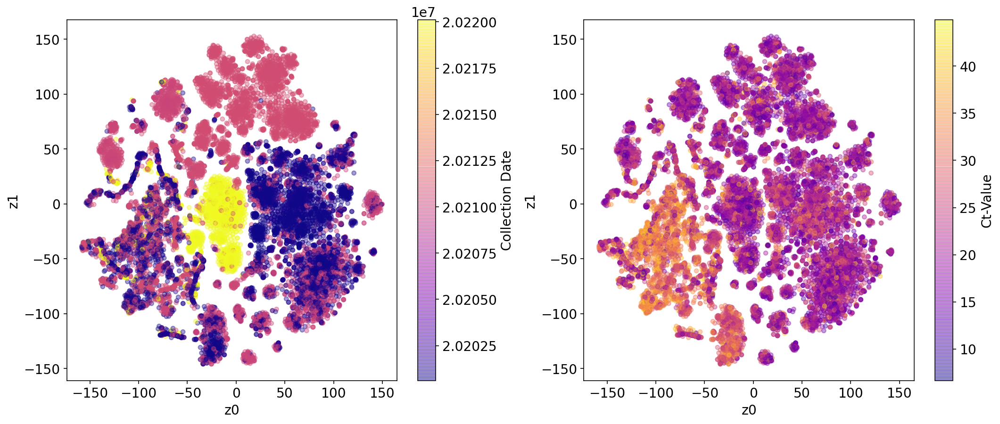

In [121]:

ct_paint = pd.DataFrame({
    "Collection Date": [int("".join(dt.split("-"))) for dt in train_annotation_df["Collection Date"]],
    "Ct-Value": train_annotation_df["Ct-Value"].values
})
visualize.get_cluster(embed_data=embed_avg, paint_df=ct_paint, tsne_umap="tsne", get_subplots=True)

[W] [19:06:46.256074] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...


{'B.1.1 EmbedDistance':                z0          z1  B.1.1 EmbedDistance
 0       66.917664   35.416775             0.005840
 1      -56.230785  120.586662             0.141177
 2     -119.286789  -80.472725             0.528668
 3       21.451954  131.295227             0.141922
 4       68.636795  -66.432846             0.003624
 ...           ...         ...                  ...
 16540  -85.639229   68.507568             0.030092
 16541  -45.294777   19.569122             0.029921
 16542   58.577866   12.597404             0.004094
 16543    2.709636  148.964050             0.142753
 16544 -105.343254  -72.496956             0.418145
 
 [16545 rows x 3 columns],
 'AY.25 EmbedDistance':                z0          z1  AY.25 EmbedDistance
 0       66.917664   35.416775             0.142046
 1      -56.230785  120.586662             0.006232
 2     -119.286789  -80.472725             0.637053
 3       21.451954  131.295227             0.004477
 4       68.636795  -66.432846           

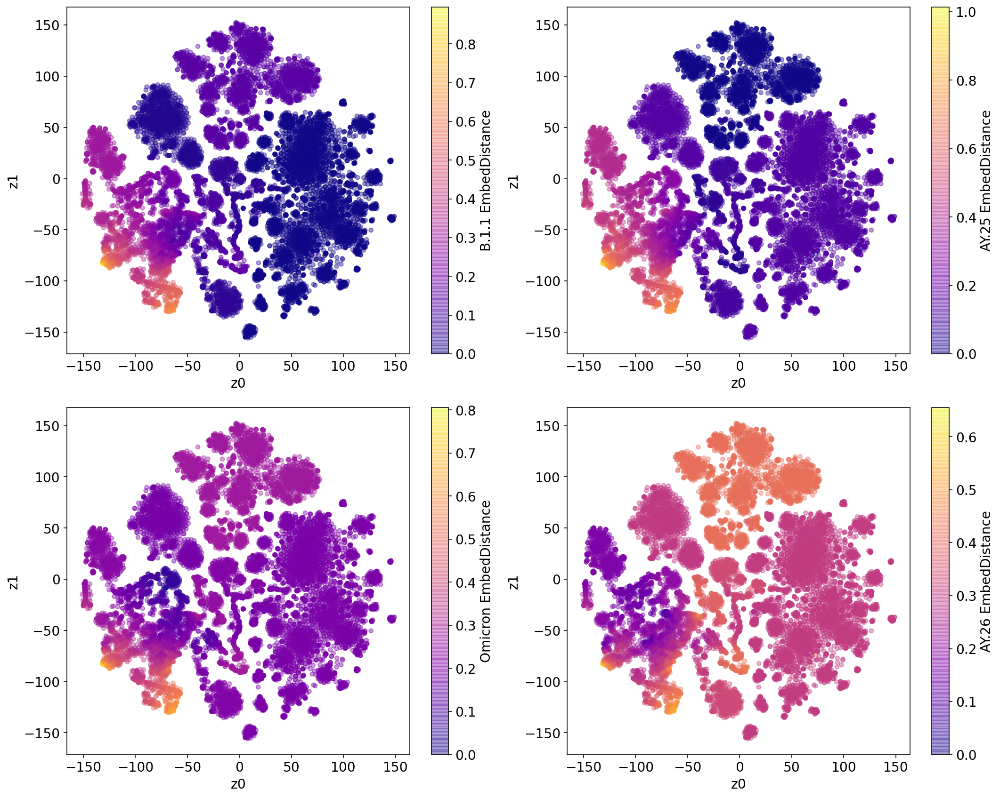

In [111]:
dist_paint = pd.DataFrame({
    "B.1.1 EmbedDistance": oldest_embed_distances,
    "AY.25 EmbedDistance": mid_embed_distances,
    "Omicron EmbedDistance": latest_embed_distances,
    "AY.26 EmbedDistance": mid2_embed_distances,
    #"Collection Date": [int("".join(dt.split("-"))) for dt in train_annotation_df["Collection Date"]],
})
tsne_df_2 = visualize.get_cluster(embed_data=embed_avg, paint_df=dist_paint, tsne_umap="tsne", get_subplots=True)
tsne_df_2

In [113]:
print("Distance between B.1.1 and Omicron:", np.linalg.norm(embed_avg[oldest_idx] - embed_avg[latest_idx]))

Distance between B.1.1 and Omicron: 0.01093569


array([[<AxesSubplot:title={'center':'B.1.1 EmbedDistance'}>,
        <AxesSubplot:title={'center':'AY.25 EmbedDistance'}>],
       [<AxesSubplot:title={'center':'Omicron EmbedDistance'}>,
        <AxesSubplot:title={'center':'AY.26 EmbedDistance'}>]],
      dtype=object)

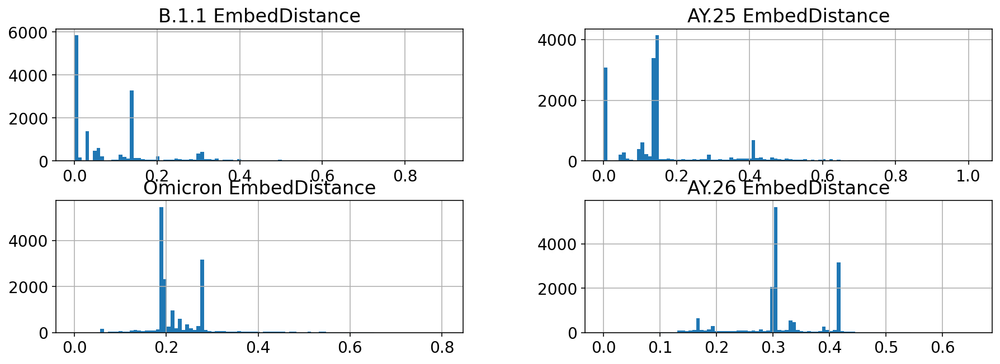

In [114]:
dist_paint.hist(bins=100, figsize=(15, 5))

In [84]:
for key in dist_paint.keys():
    print(key, sum(dist_paint[key] < 0.005) / len(dist_paint))

B.1.1 EmbedDistance 0.533212450891508
AY.25 EmbedDistance 0.22840737382895135
Omicron EmbedDistance 0.01656089453006951
AY.26 EmbedDistance 0.00024176488365064975


In [117]:
embed_avg.shape

(16545, 512)

In [129]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split
X, y = embed_avg, train_annotation_df["Ct-Value"].values
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1)
regr = MLPRegressor(random_state=1, max_iter=500, early_stopping=True, verbose=True).fit(X_train, y_train)

Iteration 1, loss = 272.27424420
Validation score: -10.267378
Iteration 2, loss = 248.49122036
Validation score: -8.934692
Iteration 3, loss = 211.02629824
Validation score: -7.042392
Iteration 4, loss = 164.08494413
Validation score: -4.922210
Iteration 5, loss = 116.30569284
Validation score: -2.973386
Iteration 6, loss = 75.98754237
Validation score: -1.496320
Iteration 7, loss = 48.07362407
Validation score: -0.595266
Iteration 8, loss = 32.58934742
Validation score: -0.166896
Iteration 9, loss = 25.81616758
Validation score: -0.012034
Iteration 10, loss = 23.49198969
Validation score: 0.030934
Iteration 11, loss = 22.84758500
Validation score: 0.039913
Iteration 12, loss = 22.67250180
Validation score: 0.041942
Iteration 13, loss = 22.60439646
Validation score: 0.043428
Iteration 14, loss = 22.55755120
Validation score: 0.045070
Iteration 15, loss = 22.51397407
Validation score: 0.046836
Iteration 16, loss = 22.47169438
Validation score: 0.048740
Iteration 17, loss = 22.42895473
V

Iteration 137, loss = 20.39021910
Validation score: 0.150368
Iteration 138, loss = 20.38256846
Validation score: 0.152335
Iteration 139, loss = 20.36231696
Validation score: 0.152747
Iteration 140, loss = 20.36280164
Validation score: 0.151497
Iteration 141, loss = 20.35335122
Validation score: 0.152233
Iteration 142, loss = 20.35383534
Validation score: 0.153089
Iteration 143, loss = 20.34489286
Validation score: 0.153359
Iteration 144, loss = 20.34328165
Validation score: 0.154089
Iteration 145, loss = 20.33452984
Validation score: 0.153811
Iteration 146, loss = 20.33661343
Validation score: 0.153154
Iteration 147, loss = 20.34050493
Validation score: 0.152569
Iteration 148, loss = 20.32179659
Validation score: 0.154939
Iteration 149, loss = 20.32046286
Validation score: 0.154226
Iteration 150, loss = 20.31438212
Validation score: 0.153589
Iteration 151, loss = 20.31666392
Validation score: 0.154918
Iteration 152, loss = 20.31151988
Validation score: 0.153926
Iteration 153, loss = 20

Iteration 272, loss = 19.89031050
Validation score: 0.175737
Iteration 273, loss = 19.88550500
Validation score: 0.173995
Iteration 274, loss = 19.88659322
Validation score: 0.175302
Iteration 275, loss = 19.88592574
Validation score: 0.176295
Iteration 276, loss = 19.88668431
Validation score: 0.177570
Iteration 277, loss = 19.87175661
Validation score: 0.174940
Iteration 278, loss = 19.88760742
Validation score: 0.177799
Iteration 279, loss = 19.87242511
Validation score: 0.177712
Iteration 280, loss = 19.86819142
Validation score: 0.175813
Iteration 281, loss = 19.86419171
Validation score: 0.178368
Iteration 282, loss = 19.85898166
Validation score: 0.179002
Iteration 283, loss = 19.86167002
Validation score: 0.178052
Iteration 284, loss = 19.87569882
Validation score: 0.179154
Iteration 285, loss = 19.86579979
Validation score: 0.178502
Iteration 286, loss = 19.85355812
Validation score: 0.174950
Iteration 287, loss = 19.86083580
Validation score: 0.177376
Iteration 288, loss = 19

In [130]:
print("Train: ", regr.score(X_train, y_train))
print("Test: ", regr.score(X_test, y_test))

Train:  0.16554304207384873
Test:  0.1605407801340567


<AxesSubplot:>

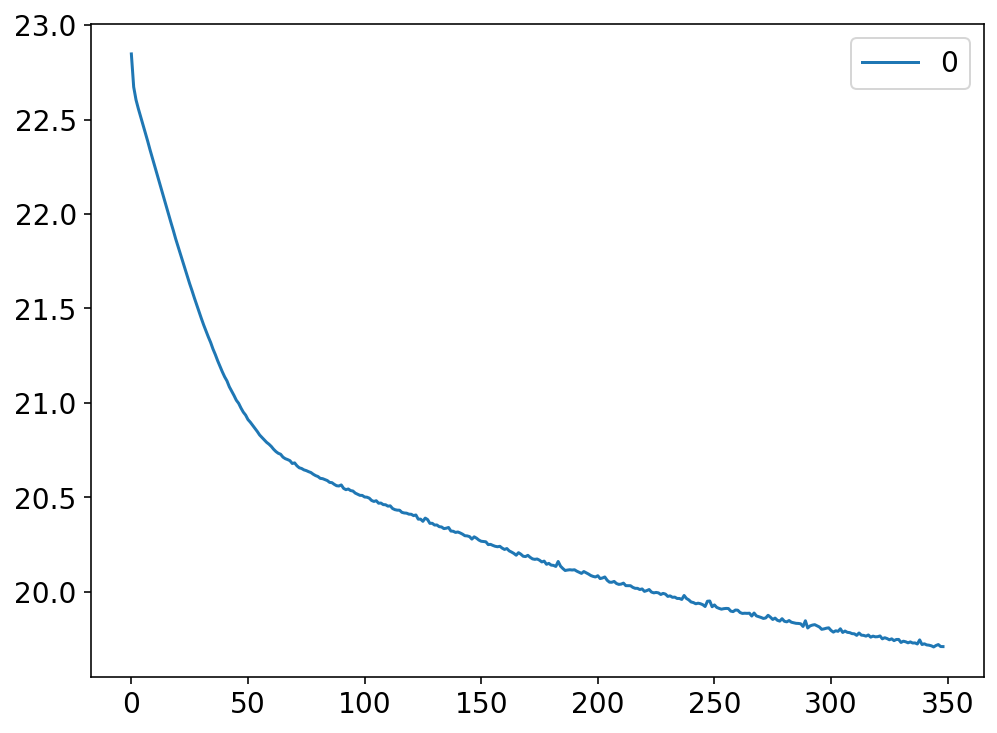

In [132]:
pd.DataFrame(regr.loss_curve_[10:]).plot()

In [80]:
from sklearn.decomposition import PCA
import os
from datetime import datetime
from pathlib import Path
from tqdm import tqdm
import pandas as pd
from collections import defaultdict
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.figure_factory as ff
from typing import Optional, Tuple, List
from sklearn.decomposition import PCA
LABEL_FONTSIZE = 20

def plot_scatter_mpl(
    data: np.ndarray,
    color: np.ndarray,
    cbar_pad: float = 0.1,
    cbar_label: str = "",
    cmap: str = "plasma",
    cbar_min: float = None,
    cbar_max: float = None,
    z1_min_max: Optional[Tuple[float, float]] = None,
    z2_min_max: Optional[Tuple[float, float]] = None,
    z3_min_max: Optional[Tuple[float, float]] = None,
):
    z1, z2, z3 = data[:, 0], data[:, 1], data[:, 2]
    z1_min_max = z1_min_max if z1_min_max is not None else (np.min(z1), np.max(z1))
    z2_min_max = z2_min_max if z2_min_max is not None else (np.min(z2), np.max(z2))
    z3_min_max = z3_min_max if z3_min_max is not None else (np.min(z3), np.max(z3))
    fig = plt.figure()
    ax = fig.add_subplot(111, projection="3d")
    vmin = cbar_min if cbar_min is not None else np.min(color)
    vmax = cbar_max if cbar_max is not None else np.max(color)
    cnorm = matplotlib.colors.Normalize(
        vmin=vmin, vmax=vmax
    )
    scalar_map = matplotlib.cm.ScalarMappable(norm=cnorm, cmap=plt.get_cmap(cmap))
    scalar_map.set_array(color)
    fig.colorbar(scalar_map, pad=cbar_pad).set_label(label=cbar_label,size=LABEL_FONTSIZE)
    c = scalar_map.to_rgba(color)
    ax.scatter3D(z1, z2, z3, marker=".", c=c)
    ax.set_xlim3d(z1_min_max)
    ax.set_ylim3d(z2_min_max)
    ax.set_zlim3d(z3_min_max)
    ax.set_xlabel(r"$z_1$", fontsize=LABEL_FONTSIZE)
    ax.set_ylabel(r"$z_2$", fontsize=LABEL_FONTSIZE)
    ax.set_zlabel(r"$z_3$", fontsize=LABEL_FONTSIZE)
    plt.tight_layout()
    
def run_pca(data: np.ndarray, n_components: int = 3):
    pca = PCA(n_components=n_components)
    principal_components = pca.fit_transform(data)
    return principal_components

In [81]:
pc = run_pca(embed_avg)

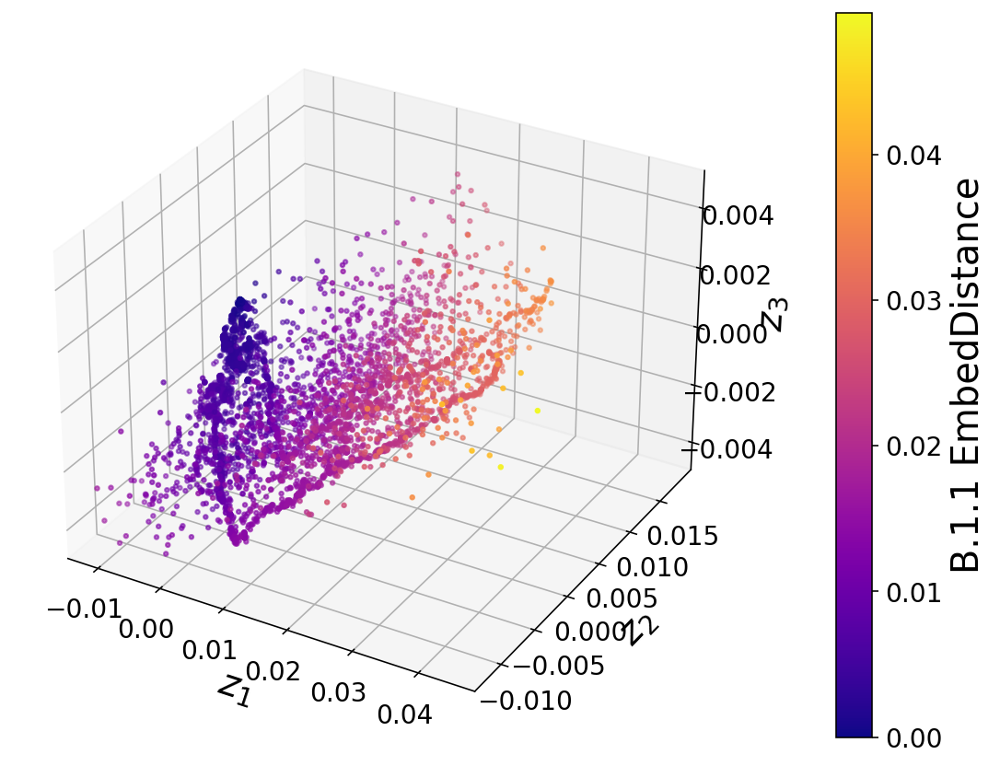

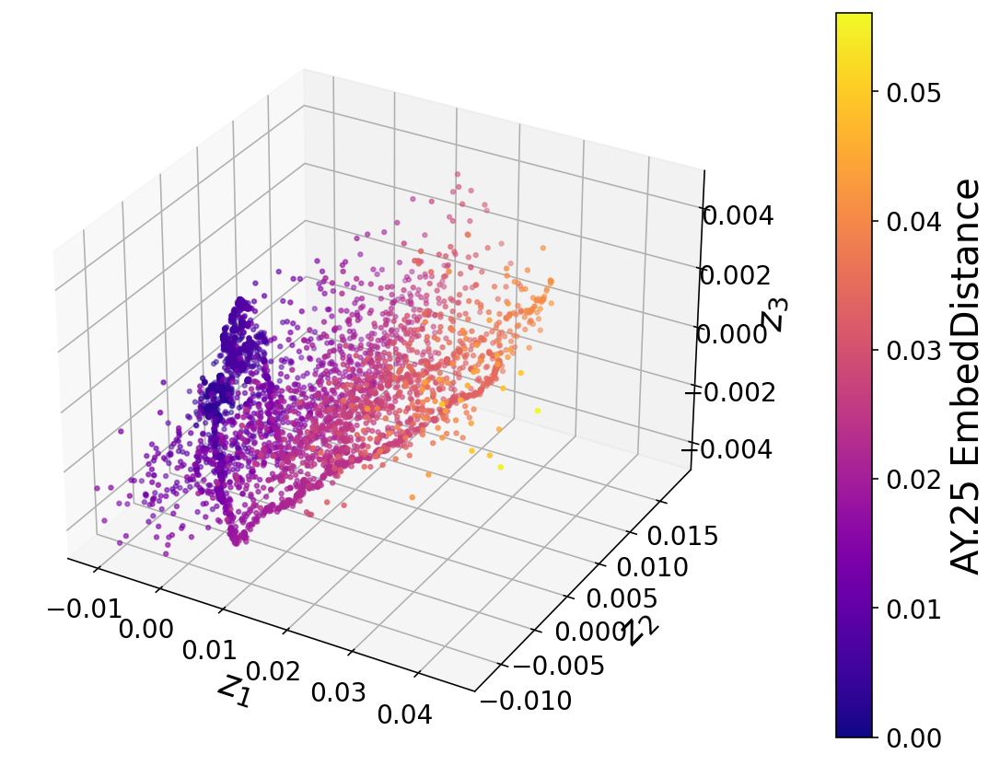

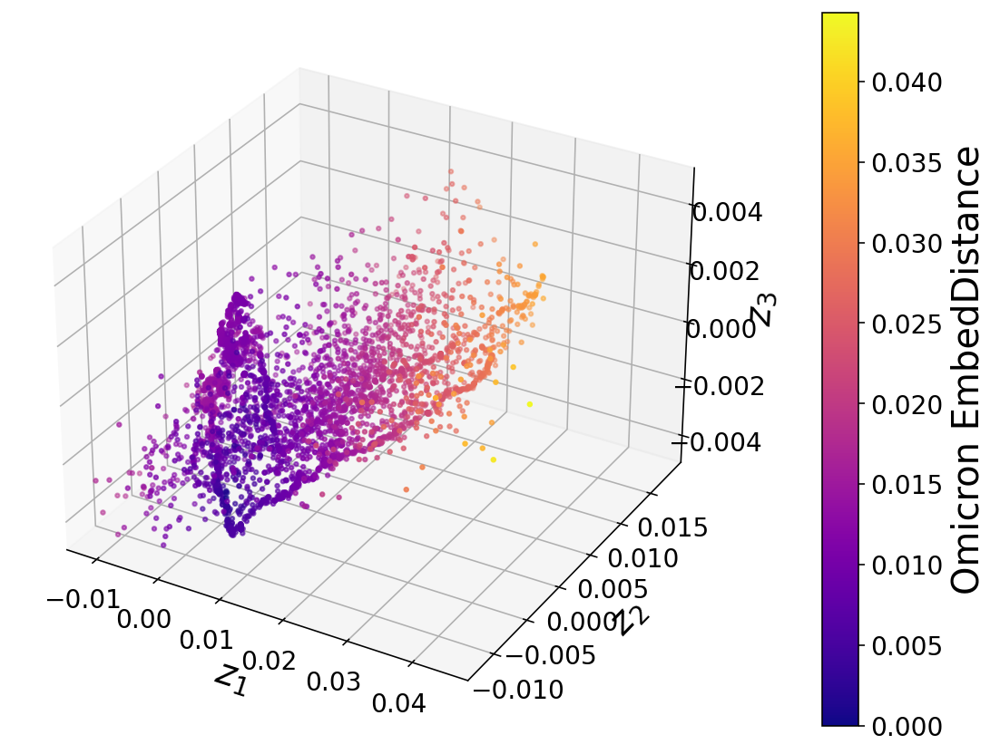

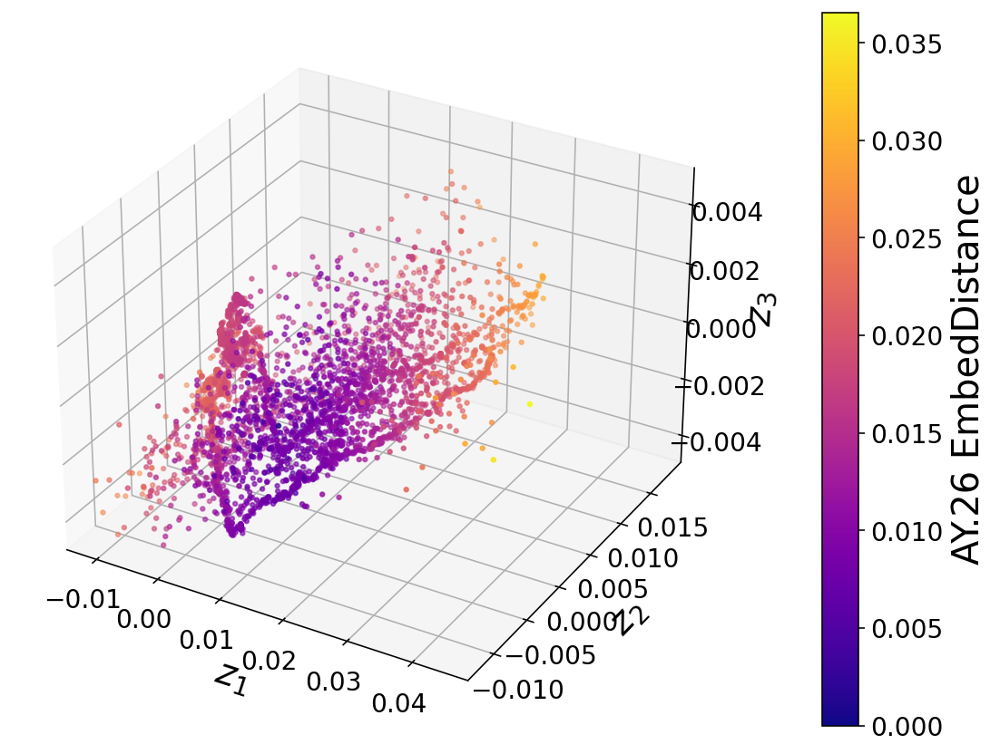

In [82]:
for key in dist_paint.keys():
    plot_scatter_mpl(pc, dist_paint[key], cbar_pad=0.1, cbar_label=str(key), cmap="plasma")

# Beta sampling

In [14]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(
    n_components=40,
    covariance_type="diag",
    init_params="kmeans",
    random_state=42,
    verbose=True
)

gmm.fit(embed_avg)
bic = gmm.bic(embed_avg)
gmm_labels = gmm.predict(embed_avg)

print("BIC:", bic)

Initialization 0
  Iteration 10
  Iteration 20
  Iteration 30
Initialization converged: True
BIC: -155556161.54202598


In [15]:
def plot_overlay(
    proj: np.ndarray,
    paint: np.ndarray,
    paint_name: str,
    train_len: int,
    legend_label: str = "Generated",
) -> None:
    df = pd.DataFrame({
            "z0": proj[:train_len, 0],
            "z1": proj[:train_len, 1],
            paint_name: paint[:train_len],
    })
    ax = plt.scatter(x=df.z0, y=df.z1, c=df[paint_name], cmap="plasma", alpha=0.4)
    cbar = plt.colorbar(ax)
    cbar.set_label(paint_name)
    # Generated
    df = pd.DataFrame({
            "z0": proj[train_len:, 0],
            "z1": proj[train_len:, 1],
            paint_name: paint[train_len:],
    })
    plt.scatter(x=df.z0, y=df.z1, c="k", alpha=0.2, label=legend_label)
    plt.legend(loc="upper left")
    plt.show()

def beta_sampling(
    metric: np.ndarray,
    labels: np.ndarray,
    num_to_sample: int,
    alpha: int = 1,
    beta: int = 15,
    seed: int = 0,
):
    """To maximize over the metric, choose alpha=20, beta=1.
    To minimize, choose alpha=1, beta=20. To uniformly sample,
    choose alpha=1, beta=1. To sample around the mean, choose
    alpha=beta=const (if you increase const, the samples will
    be very close to the mean. Decreasing const will be more
    uniformly distributed.)
    """
    np.random.seed(seed)
    n_examples = len(metric)
    assert n_examples == len(labels)
    assert num_to_sample <= n_examples
    
    clusters = np.unique(labels)
    n_clusters = len(clusters)
    original_inds = np.arange(n_examples)
    
    sampled_inds = {}
    
    for label in clusters:
        # Consider a given cluster
        mask = labels == label
        # Within the cluster, sort the indices by the metric (low to high)
        cluster_inds = np.argsort(metric[mask])
        # Compute the size of the given cluster
        n_cluster = len(cluster_inds)
        # Sample n_cluster / n_seqs samples from the 
        # given cluster in proportion to the metric
        sample_inds = (np.random.beta(a=alpha, b=beta, size=(1000,)) * n_cluster).astype(int)
        # Get unique inds while preserving order
        unique, inds = np.unique(sample_inds, return_index=True)
        unique_inds = unique[np.argsort(inds)]
        unique_inds = cluster_inds[unique_inds]
        # Keep num_to_sample * (n_cluster / n_examples) samples per cluster
        num_to_sample_in_cluster = round(num_to_sample * n_cluster / n_examples)
        assert len(unique_inds) > num_to_sample_in_cluster, "Not enough unique points sampled, run again"
        # Only keep up to num_to_sample_in_cluster per cluster
        unique_inds = unique_inds[:num_to_sample_in_cluster]
        # Get the original indices of the full dataset
        real_inds = original_inds[mask][unique_inds]
        sampled_inds[label] = real_inds
  
    return sampled_inds

In [16]:
labels

,GC,SequenceLength
0,37.995441,29393
1,37.976861,29647
2,38.009295,29477
3,37.946624,29639
4,37.958797,29561
...,...,...
25561,37.990353,29647
25562,37.939286,29252
25563,37.980364,29639
25564,37.970242,29639


<AxesSubplot:>

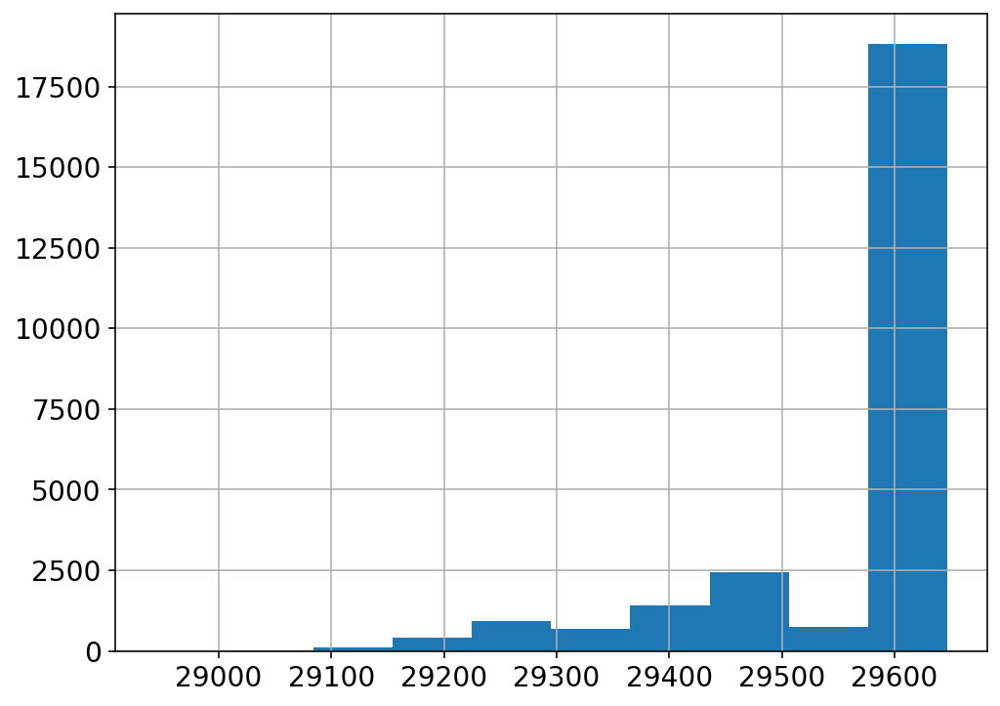

In [17]:
labels.SequenceLength.hist()

In [18]:
metric = labels["SequenceLength"].values.copy()
sampled_inds = beta_sampling(metric, gmm_labels, num_to_sample=1000, alpha=1, beta=1, seed=50)
sampled_inds = np.concatenate(list(sampled_inds.values()))

<AxesSubplot:>

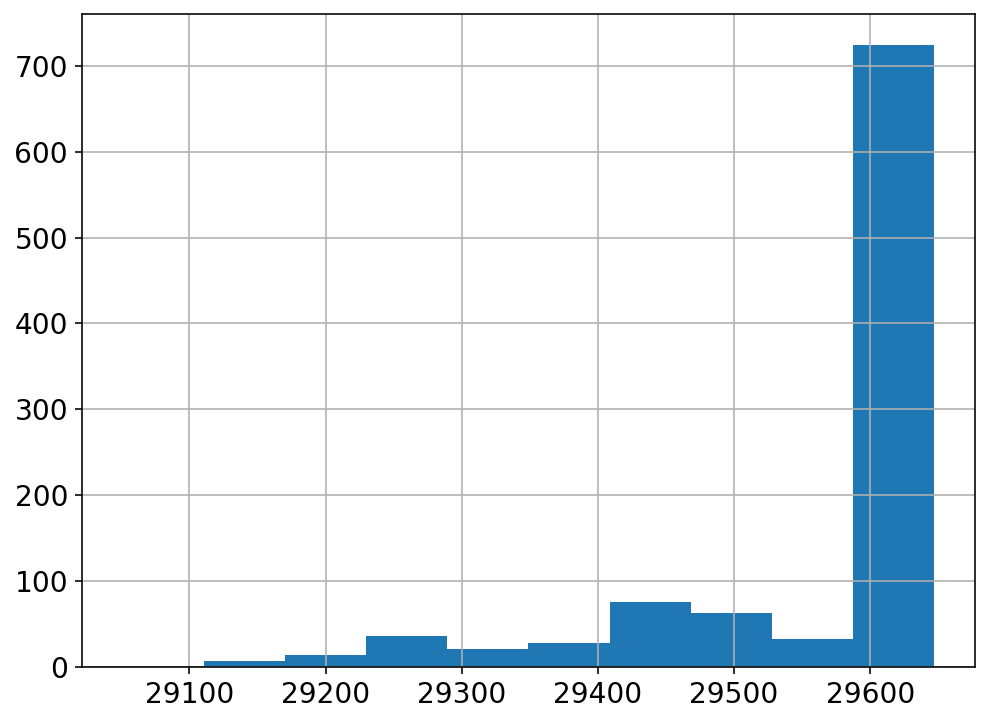

In [20]:
labels.SequenceLength[sampled_inds].hist()

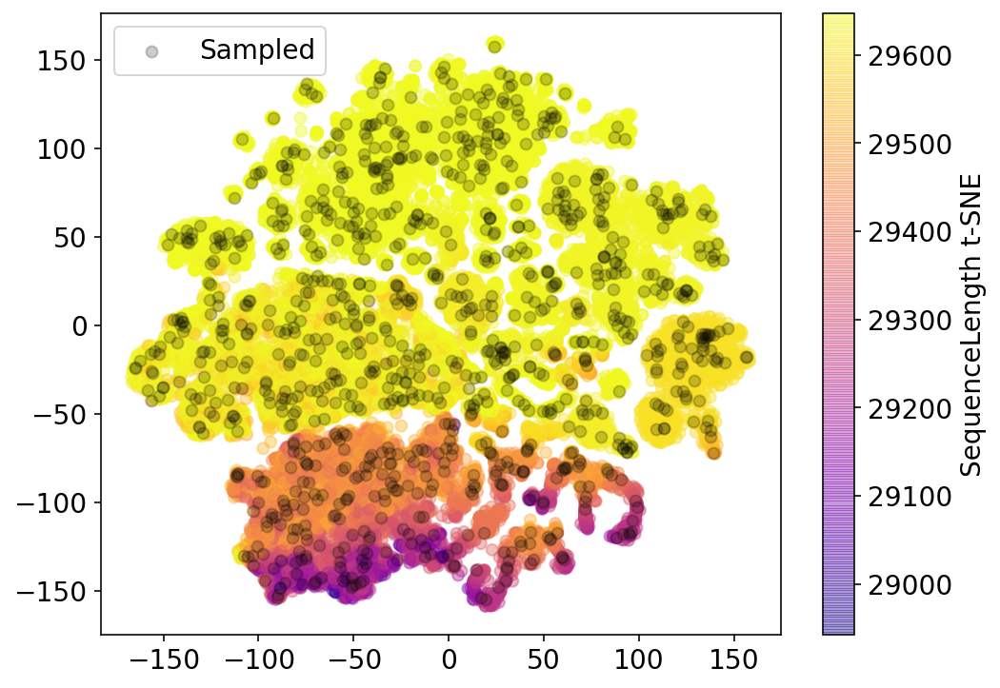

In [21]:
train_tsne_proj = tsne_df["SequenceLength"].values[:, :2]

metric = labels["SequenceLength"].values.copy()
tsne_proj = np.concatenate((train_tsne_proj, train_tsne_proj[sampled_inds]))
paint = np.concatenate((metric, metric[sampled_inds]))
plot_overlay(tsne_proj, paint, f"SequenceLength t-SNE", len(train_tsne_proj), legend_label="Sampled")

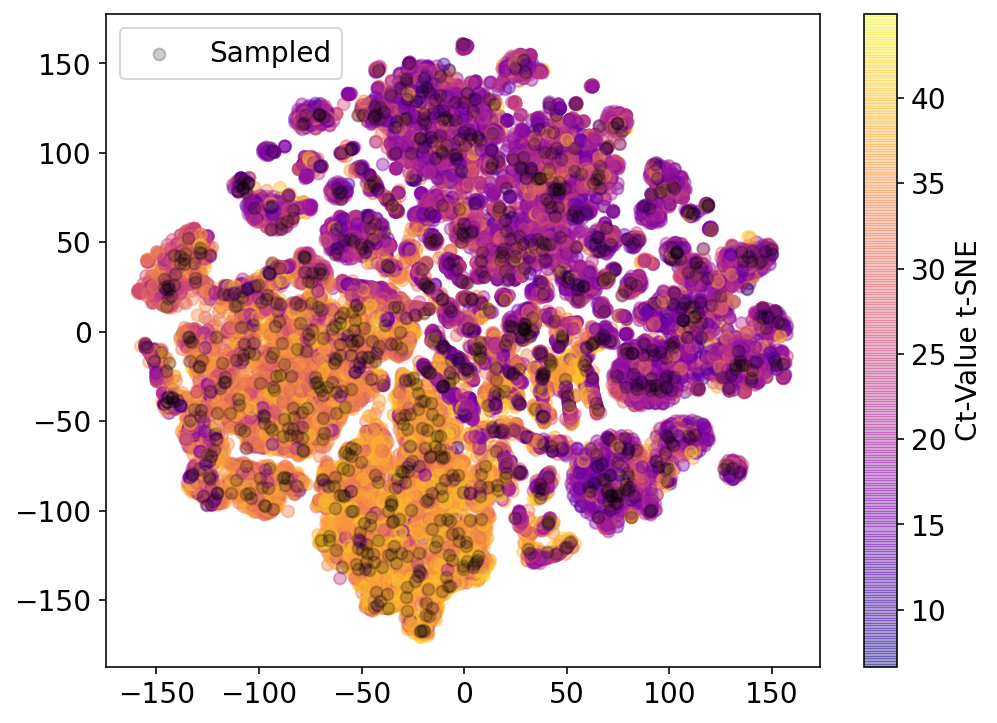

In [13]:
metric = train_annotation_df["Ct-Value"].values.copy()
tsne_proj = np.concatenate((train_tsne_proj, train_tsne_proj[sampled_inds]))
paint = np.concatenate((metric, metric[sampled_inds]))
plot_overlay(tsne_proj, paint, f"Ct-Value t-SNE", len(train_tsne_proj), legend_label="Sampled")

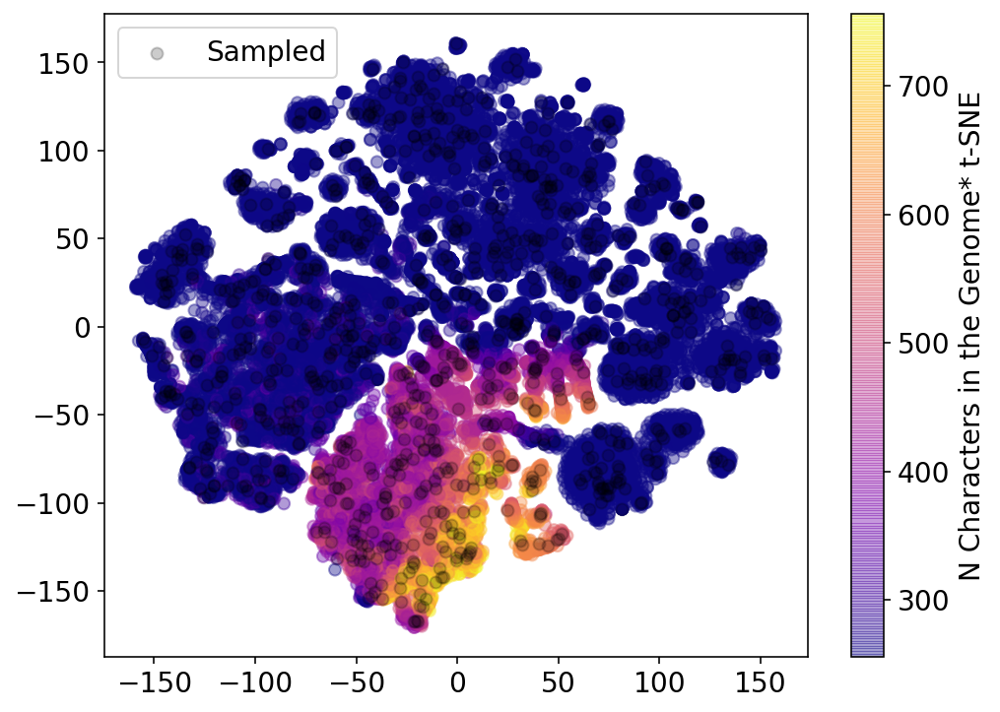

In [14]:
metric_name = "N Characters in the Genome*"
metric = train_annotation_df[metric_name].values.copy()
tsne_proj = np.concatenate((train_tsne_proj, train_tsne_proj[sampled_inds]))
paint = np.concatenate((metric, metric[sampled_inds]))
plot_overlay(tsne_proj, paint, f"{metric_name} t-SNE", len(train_tsne_proj), legend_label="Sampled")

### Write fasta with this subset to create a phylogentic tree 

In [22]:
corrected_sequences[0]

SeqRecord(seq=Seq('NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN...NNN'), id='MCoV-33204', name='MCoV-33204', description='MCoV-33204', dbxrefs=[])

In [23]:
sampled_seqs = [corrected_sequences[ind] for ind in sampled_inds]
SeqIO.write(sampled_seqs, "/homes/abrace/data/sequences/sars-cov2-genome/jim-data/jim-data-1000subsample-corrected.fasta", "fasta")

1000

In [23]:
train_annotation_df

,Genome ID,GISAID ID,Collection Date,N Characters in the Genome*,Instrument,Ct-Value,Variant (Pangolin)
10816,MCoV-33204,EPI_ISL_2200160,2020-12-17,460.0,ALINITY,34.03,B.1.595
8968,MCoV-18768,EPI_ISL_785100,2020-11-23,256.0,ALINITY,26.88,B.1.2
16109,MCoV-25690,EPI_ISL_1080183,2021-02-01,420.0,ALINITY,39.52,B.1
23261,MCoV-58925,EPI_ISL_5346564,2021-08-25,256.0,ALINITY,15.22,AY.3
21514,MCoV-54494,EPI_ISL_5338065,2021-08-10,334.0,PANTHER,38.20,B.1.617.2
...,...,...,...,...,...,...,...
5151,MCoV-12920,EPI_ISL_788072,2020-08-18,256.0,ALINITY,25.05,B.1.2
28718,MCoV-74803,EPI_ISL_9204095,2022-01-04,612.0,ALINITY,17.25,omicron
17112,MCoV-28273,EPI_ISL_1238055,2021-02-19,262.0,ALINITY,32.72,R.1
20134,MCoV-50978,EPI_ISL_5340193,2021-07-21,256.0,ALINITY,11.15,AY.25


In [17]:
prefixs = [str(value)[0] for value in train_annotation_df["Variant (Pangolin)"].values]

In [18]:
Counter(prefixs)

Counter({'B': 12672,
         'A': 1867,
         'o': 1846,
         'P': 105,
         'n': 5,
         'N': 15,
         'R': 17,
         'C': 11,
         'L': 1,
         'Q': 6})

In [19]:
train_annotation_df["Variant (Pangolin) preffix"] = prefixs

In [20]:
varient_enc = LabelEncoder()

plot_df = pd.DataFrame({
    "z0": tsne_df["SequenceLength"].values[:, 0],
    "z1": tsne_df["SequenceLength"].values[:, 1],
    "real-variant-label": train_annotation_df["Variant (Pangolin) preffix"],
    "variant-label": varient_enc.fit_transform(train_annotation_df["Variant (Pangolin) preffix"]),
}).sort_values(by=['real-variant-label'])

plot_df

,z0,z1,real-variant-label,variant-label
19832,-50.041252,-108.280617,A,0
22886,142.278519,-28.293072,A,0
22907,-41.644943,123.606827,A,0
21792,-16.045071,154.739502,A,0
24397,-41.768459,122.887039,A,0
...,...,...,...,...
30975,81.379913,-52.340061,o,9
31286,92.594200,-70.912956,o,9
30732,73.888596,-57.672588,o,9
31266,44.313812,-39.785759,o,9


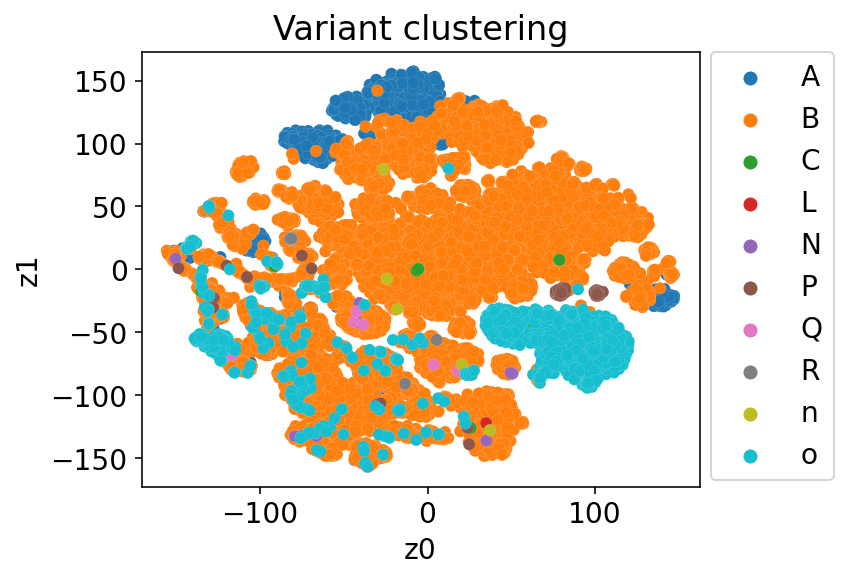

In [24]:
fig, ax = plt.subplots(figsize=(5, 4))
ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-variant-label", 
                     palette="tab10", linewidth=0.05, ax=ax)
ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.title("Variant clustering")
plt.savefig("arvind-livermore-10-4-sars-cov2-genome-clustering-variant-label.png", dpi=300, bbox_inches="tight")
plt.show()

In [ ]:
# TODO: Color by distance to original variant

# Smalll 1000 Subset of the 1.5M COVID Genomes

In [25]:
val_embed_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/validaion_1000seq_subsample.npy")
val_h5_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/validation_1000seq_subsample.h5")

seqs, descriptions, ids = load_seqs(val_h5_path)
embed_avg = np.load(val_embed_path)

In [29]:
classes = get_classes(descriptions)
classes

,strain,variant,region,species,variant-label,region-label,time
0,OK441256.1,AY.25,USA: Massachusetts,Homo sapiens,AY,USA,2021-09-30
1,OU207376.1,B.1.1.7,Pakistan,Homo sapiens,B,Pakistan,2021-04-09
2,OK578537.1,AY.44,USA: Texas,Homo sapiens,AY,USA,2021-09-08
3,OM894658.1,BA.1.1,USA: Connecticut,Homo sapiens,BA,USA,2022-02-13
4,MZ412411.1,B.1.637,USA: North Carolina,Homo sapiens,B,USA,2021-06-06
...,...,...,...,...,...,...,...
995,OM007305.1,AY.117,USA: Connecticut,Homo sapiens,AY,USA,2021-12-05
996,MZ942084.1,AY.3,USA: West Virginia,Homo sapiens,AY,USA,2021-07-17
997,OK039779.1,AY.44,USA,Homo sapiens,AY,USA,2021-07-15
998,MT972065.1,D.2,Australia: Victoria,Homo sapiens,D,Australia,2020-07-23


In [32]:
Counter(classes["region-label"])

Counter({'USA': 813,
         'Pakistan': 1,
         'United Kingdom': 11,
         'Denmark': 8,
         'Switzerland': 26,
         'Netherlands': 2,
         'Germany': 100,
         'China': 1,
         'Bangladesh': 1,
         'France': 9,
         'Chile': 1,
         'Australia': 7,
         'Mongolia': 1,
         'India': 2,
         'Hong Kong': 2,
         'New Zealand': 1,
         'Slovakia': 4,
         'Poland': 1,
         'Mexico': 1,
         'South Africa': 1,
         'Nigeria': 1,
         'Italy': 1,
         'Japan': 1,
         'Egypt': 2,
         'Saudi Arabia': 1,
         'Spain': 1})

In [33]:
Counter(classes["variant-label"])

Counter({'AY': 502,
         'B': 284,
         'BA': 189,
         'R': 1,
         'D': 7,
         'P': 9,
         'Q': 3,
         'A': 3,
         'XB': 1,
         'C': 1})

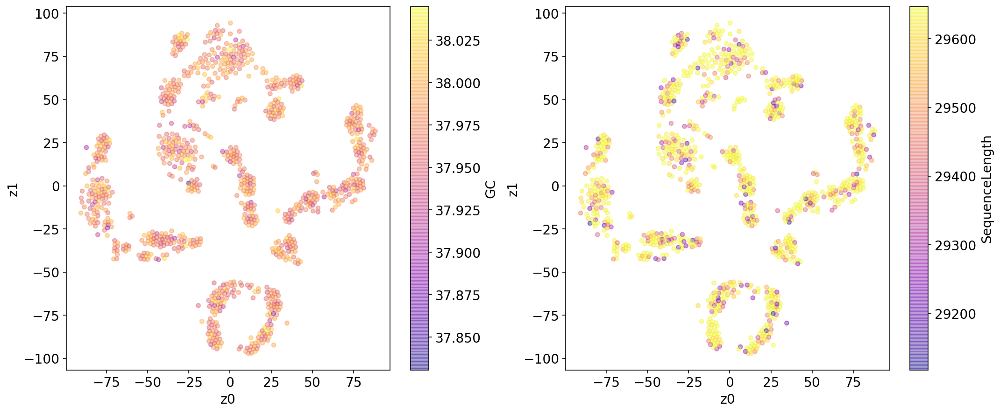

In [34]:
df = visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="tsne", get_subplots=True)

In [40]:
df

{'GC':             z0         z1         GC
 0   -80.002754  17.240473  37.995441
 1     9.099309  49.705746  37.976861
 2    -2.176176  72.690872  38.009295
 3    27.185907 -66.966782  37.946624
 4   -29.885872   3.654740  37.958797
 ..         ...        ...        ...
 995 -34.265762  61.469509  37.956504
 996 -70.592430 -42.407009  37.997149
 997 -31.027042  61.220119  37.998381
 998  20.654051 -85.400459  37.977589
 999 -76.457161 -10.053875  37.960120
 
 [1000 rows x 3 columns],
 'SequenceLength':             z0         z1  SequenceLength
 0   -80.002754  17.240473           29393
 1     9.099309  49.705746           29647
 2    -2.176176  72.690872           29477
 3    27.185907 -66.966782           29639
 4   -29.885872   3.654740           29561
 ..         ...        ...             ...
 995 -34.265762  61.469509           29244
 996 -70.592430 -42.407009           29468
 997 -31.027042  61.220119           29646
 998  20.654051 -85.400459           29628
 999 -76.457161 -10

In [43]:
varient_enc = LabelEncoder()
region_enc = LabelEncoder()

plot_df = pd.DataFrame({
    "z0": df["GC"]["z0"],
    "z1": df["GC"]["z1"],
    "real-variant-label": classes["variant-label"],
    "real-region-label": classes["region-label"],
    "variant-label": varient_enc.fit_transform(classes["variant-label"]),
    "region-label": region_enc.fit_transform(classes["region-label"])
}).sort_values(by=['real-variant-label'])

plot_df

,z0,z1,real-variant-label,real-region-label,variant-label,region-label
977,24.965578,-80.469872,A,USA,0,24
764,60.361099,-0.849313,A,Spain,0,22
577,13.326345,-91.371971,A,USA,0,24
556,-85.821289,8.262683,AY,USA,1,24
558,-16.022758,57.779156,AY,USA,1,24
...,...,...,...,...,...,...
540,77.186798,39.431210,Q,USA,7,24
352,-4.059212,-57.382069,Q,USA,7,24
357,29.536800,-36.341053,Q,USA,7,24
93,5.770207,5.894365,R,USA,8,24


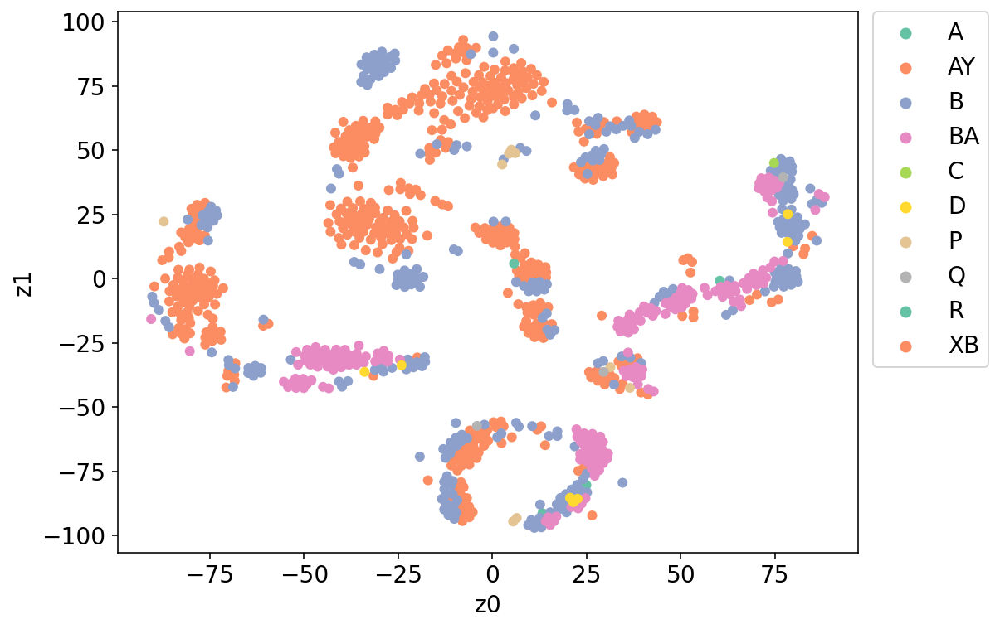

In [47]:
ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-variant-label", palette="Set2", ec=None)
ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.show()

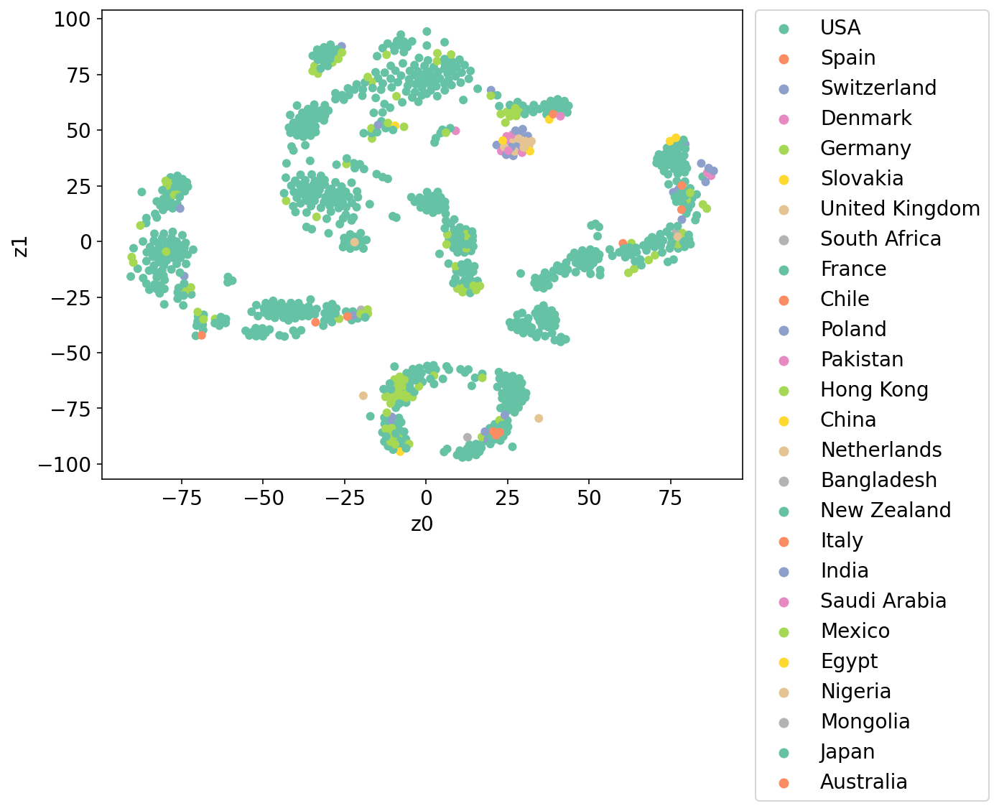

In [48]:
ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-region-label", palette="Set2", ec=None)
ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.show()

In [67]:
val_embed_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/sarscov2_filtered-50k-subsample.npy")
val_h5_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/sarscov2_filtered-50k-subsample.h5")

seqs, descriptions, ids = load_seqs(val_h5_path)
embed_avg = np.load(val_embed_path)

classes = get_classes(descriptions)
classes

,strain,variant,region,species,variant-label,region-label,time
0,NC_045512.2,B,China,Homo sapiens,B,China,2019-12
1,ON338717.1,AY.44,USA,Homo sapiens,A,USA,2021-12-01
2,ON338749.1,AY.103,USA,Homo sapiens,A,USA,2021-12-01
3,ON338790.1,AY.103,USA,Homo sapiens,A,USA,2021-12-01
4,ON338830.1,AY.44,USA,Homo sapiens,A,USA,2021-11-30
...,...,...,...,...,...,...,...
52488,MT246470.1,B.1.1,USA: WA,Homo sapiens,B,USA,2020-03-13
52489,MT192773.1,B,Viet Nam: Ho Chi Minh city,Homo sapiens,B,Viet Nam,2020-01-22
52490,MT159716.2,B,USA,Homo sapiens,B,USA,2020-02-24
52491,MT066176.1,B,Taiwan,Homo sapiens,B,Taiwan,2020-02-05


In [68]:
Counter(classes["region-label"])

Counter({'China': 15,
         'USA': 42183,
         'South Africa': 41,
         'France': 405,
         'Japan': 133,
         'United Kingdom': 496,
         'Brazil': 8,
         'Switzerland': 1876,
         'Thailand': 5,
         'Bahrain': 126,
         'Kenya': 8,
         'Peru': 9,
         'India': 58,
         'Djibouti': 17,
         'Malawi': 3,
         'Puerto Rico': 16,
         'Slovakia': 207,
         'Bangladesh': 34,
         'Paraguay': 8,
         'Jamaica': 12,
         'Dominican Republic': 12,
         'Mongolia': 19,
         'Uganda': 1,
         'Italy': 24,
         'Denmark': 472,
         'Gabon': 3,
         'Finland': 2,
         'Chile': 15,
         'Romania': 2,
         'Canada': 1,
         'Hong Kong': 55,
         'Germany': 5391,
         'Austria': 12,
         'Pakistan': 16,
         'Malaysia': 3,
         'South Korea': 2,
         'Ethiopia': 1,
         'Myanmar': 3,
         'Comoros': 1,
         'Saudi Arabia': 25,
         'Liecht

In [69]:
Counter(classes["variant-label"])

Counter({'B': 24990,
         'A': 26417,
         'U': 18,
         'X': 34,
         'Q': 158,
         'P': 435,
         'C': 84,
         'R': 45,
         'L': 2,
         'W': 2,
         'N': 5,
         'D': 303})

In [55]:
labels = get_paint_df(seqs)

[W] [22:15:13.188331] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...


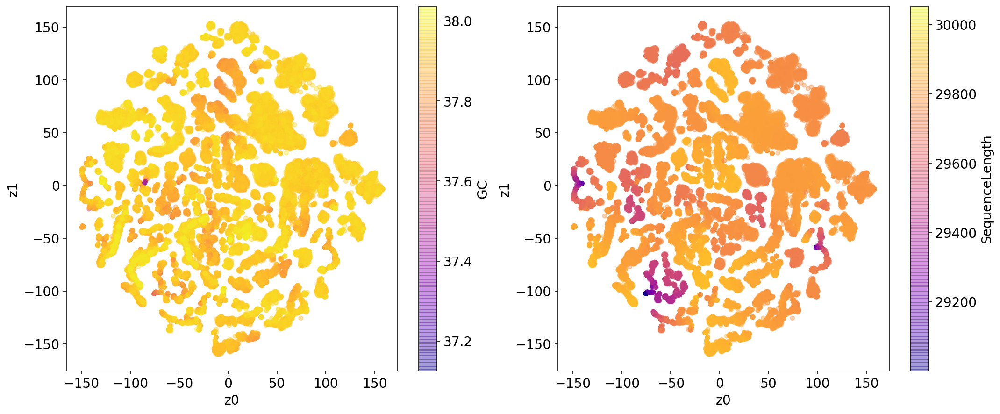

In [56]:
df = visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="tsne", get_subplots=True)

In [70]:
varient_enc = LabelEncoder()
region_enc = LabelEncoder()

plot_df = pd.DataFrame({
    "z0": df["GC"]["z0"],
    "z1": df["GC"]["z1"],
    "real-variant-label": classes["variant-label"],
    "real-region-label": classes["region-label"],
    "variant-label": varient_enc.fit_transform(classes["variant-label"]),
    "region-label": region_enc.fit_transform(classes["region-label"])
}).sort_values(by=['real-variant-label'])

plot_df

,z0,z1,real-variant-label,real-region-label,variant-label,region-label
26246,9.255656,-2.925905,A,USA,0,72
25651,129.966293,3.646523,A,USA,0,72
25652,-19.923512,55.760563,A,USA,0,72
25653,125.246094,10.426472,A,USA,0,72
25654,29.692822,54.768250,A,USA,0,72
...,...,...,...,...,...,...
9311,-8.278065,-112.452507,X,USA,11,72
35717,-55.074665,-125.916519,X,USA,11,72
39357,-54.536236,-126.054405,X,USA,11,72
33660,94.777519,-42.467140,X,USA,11,72


In [152]:
my_palettes = ['Spectral_r', 'inferno_r', 'cool', 'gist_ncar', 'mako_r', 'plasma_r']

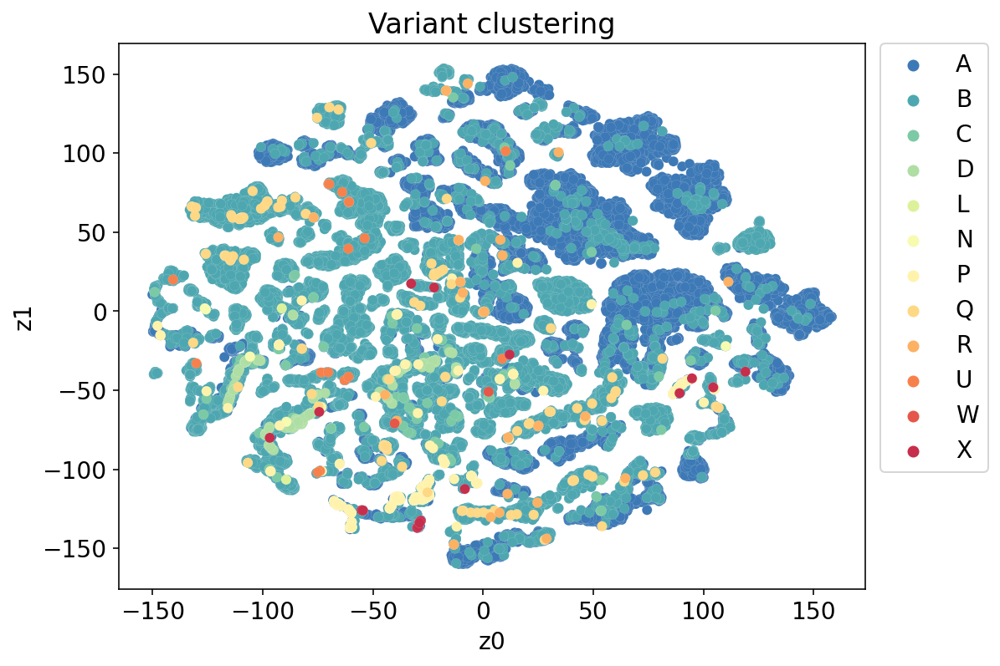

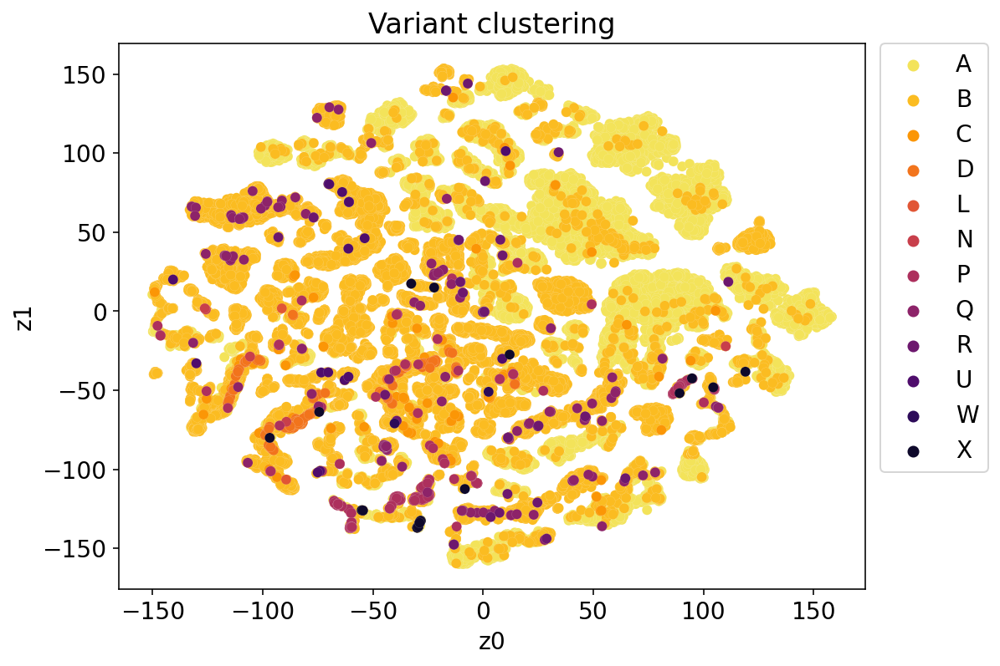

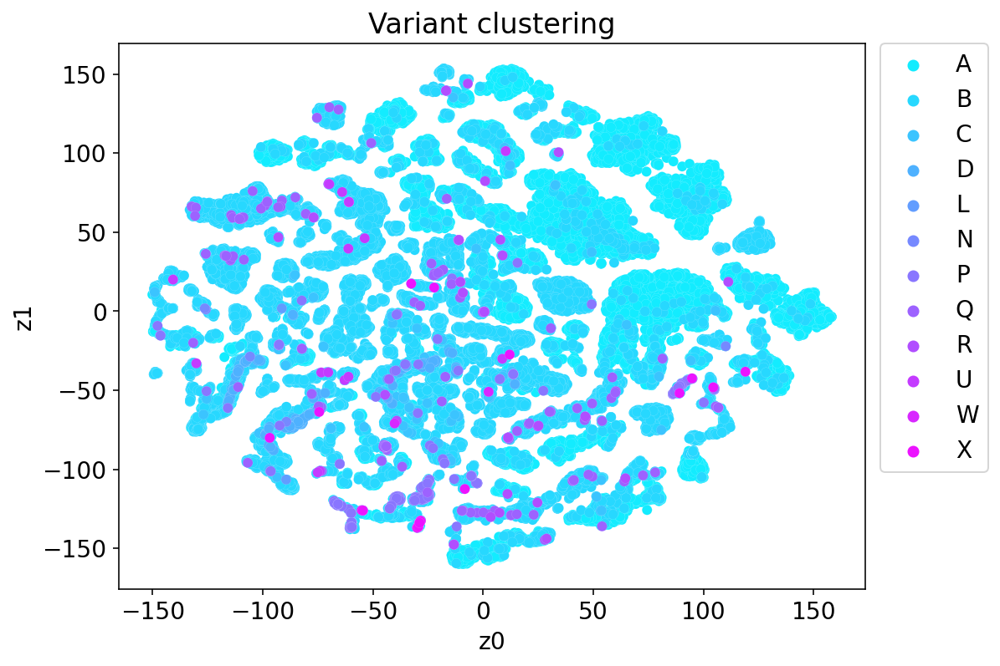

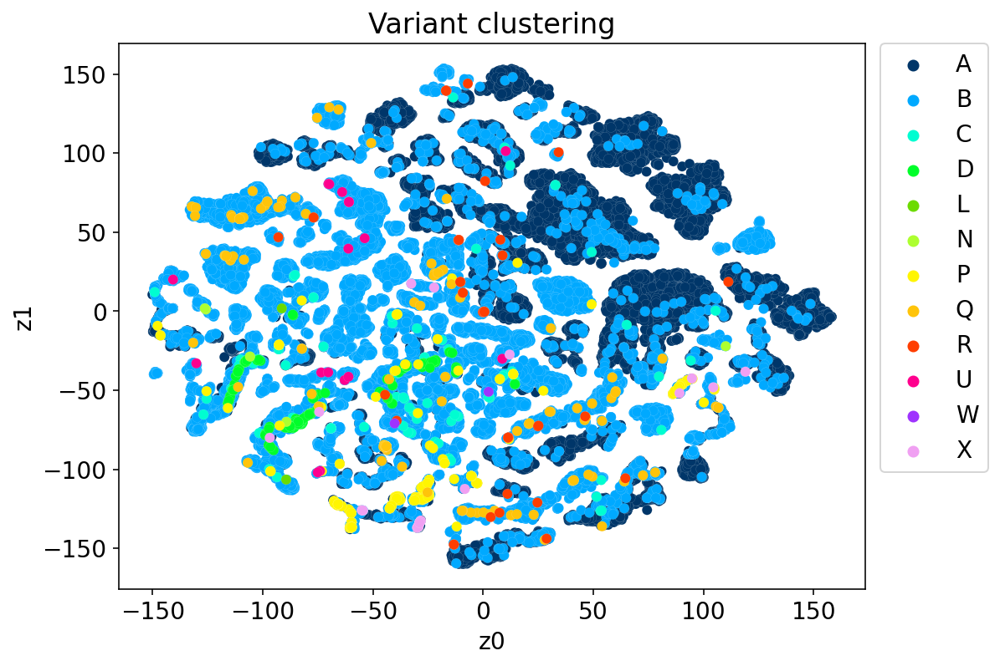

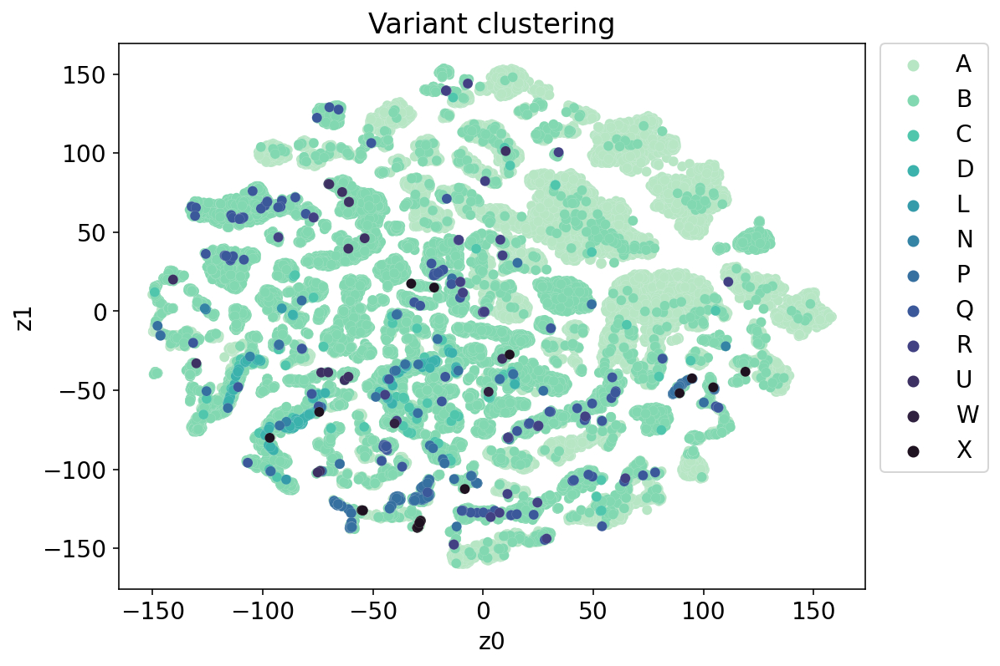

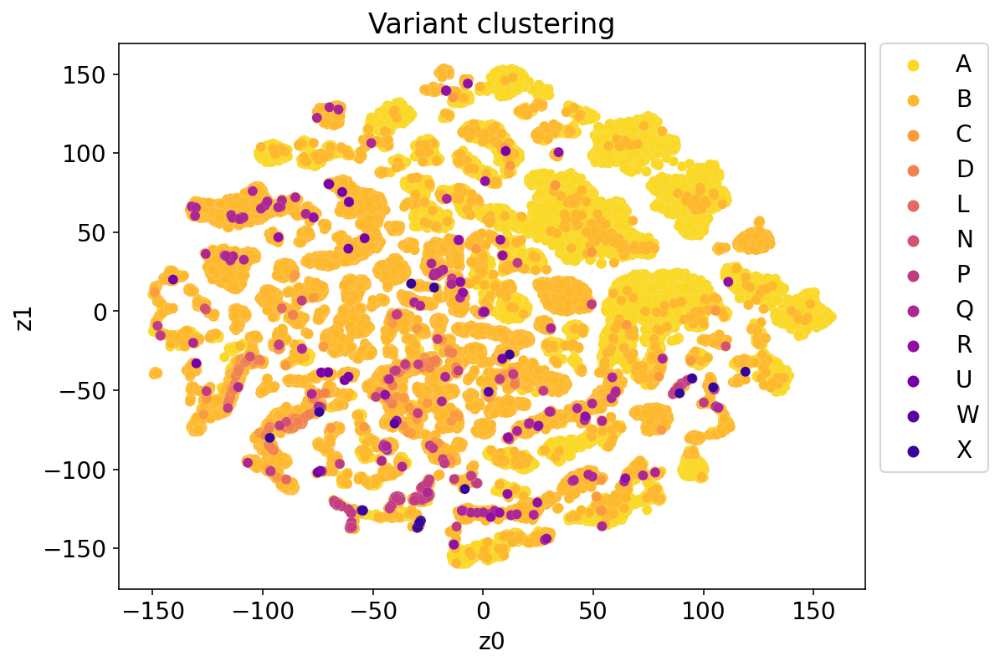

In [153]:
# "RdBu_r"
for p in my_palettes:
    #palatte = sns.color_palette(palette="hls", n_colors=len(np.unique(plot_df["variant-label"])))
    ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-variant-label", palette=p, linewidth=0.05) # mako_r  ec=None
    ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
    plt.title("Variant clustering")
    plt.show()

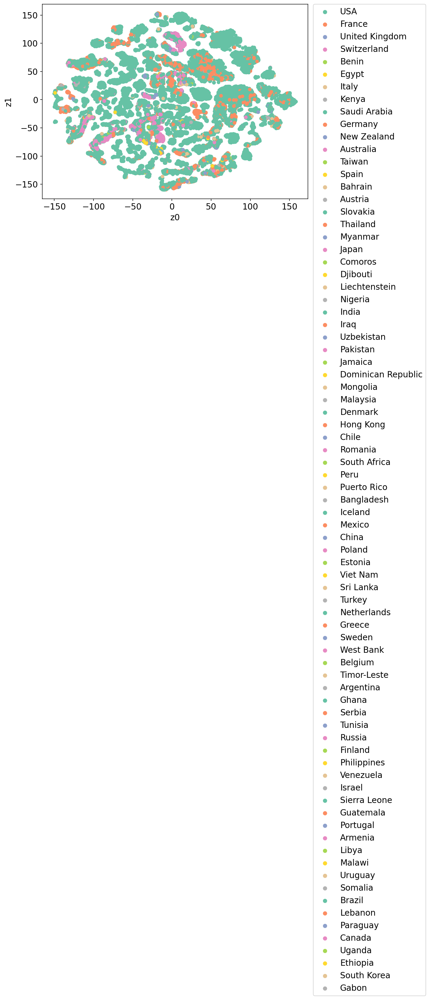

In [59]:
ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-region-label", palette="Set2", ec=None)
ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.show()

In [156]:
plot_scatter(embed_avg[:, 20:20+3], {"Variant": plot_df["variant-label"]}, "Variant")